In this notebook I will make a catalog of the magnetic field, density and temperature measurements in Jason's shotset 1.


The physical quantities are imported from Jason's scriptn pro00710 and the measurement locations are imported from script pro00170.


Each of the scripts produces a .sav file that can be read into python with the scipy.io.idl.readsav function.

In [64]:
import numpy as np
import scipy.io.idl as idl

%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('white')
sns.set_context('poster')
import matplotlib as mpl

from scipy.interpolate import griddata
import ipywidgets as widgets

# Define plotting fucntion

In [32]:
def plot_contours_in_time(quantity_dict, pos_dict, colormap, times_to_plot, cbar_label,
                          rows=11, columns=2, column_width=7, cbar_width=2, figsize=(40,100),
                          label='t'):
    r"""
    Plots contours at different time points of physical quantities with probe measurement locations.
    """
    fig = plt.figure(figsize=figsize)
    #fig.suptitle(figure_title)
    gs = mpl.gridspec.GridSpec(rows, columns*column_width + columns*cbar_width)
    column_array_element = np.asarray([0, column_width, 0, cbar_width])
    column_array = np.cumsum(np.tile(column_array_element, columns))
    plot_axes_list = []
    cbar_axes_list = []
    counter = 0
    for row in xrange(rows):
        for column in xrange(columns):
            column_index = column * 4
            axis = plt.subplot(gs[row, column_array[column_index]:column_array[column_index + 1]])
            plot_axes_list.append(axis)
            column_index = column_index + 2
            axis = plt.subplot(gs[row, column_array[column_index]:column_array[column_index + 1]])
            cbar_axes_list.append(axis) 
            counter += 1

    quantity_max = quantity_dict['a_out'].max()
    quantity_min = quantity_dict['a_out'].min()
    x_min = np.nanmin(pos_dict['x_out'])
    x_max = np.nanmax(pos_dict['x_out'])
    y_min = np.nanmin(pos_dict['y_out'])
    y_max = np.nanmax(pos_dict['y_out'])
    x_points = np.linspace(x_min, x_max, 100)
    y_points = np.linspace(y_min, y_max, 100)
    gridx, gridy = np.meshgrid(x_points, y_points)

    for i, time in enumerate(times_to_plot):
        quantity_interpolated = griddata(np.dstack((quantity_dict['x_out'], 
                                                    quantity_dict['y_out']))[0],
                                                    quantity_dict['a_out'][time],
                                                   (gridx, gridy))
        contour = plot_axes_list[i].contourf(gridx, gridy, quantity_interpolated, 
                                             cmap=colormap, vmax=quantity_max, vmin=quantity_min)
        plot_axes_list[i].set_aspect('equal')

        plot_axes_list[i].scatter(pos_dict['x_out'], pos_dict['y_out'], marker="o", 
                                  facecolor='none', edgecolor='black', s=40)
        if label=='t':
            plot_axes_list[i].set_title('t= ' +str(quantity_dict['delays'][i]) + " ms", fontsize=50)
        else:
            plot_axes_list[i].set_title(r'$\phi$ = % 2.1f $\pi$' % (quantity_dict['delays'][i]*2), fontsize=50)
        plot_axes_list[i].set_xlabel('x [m]', fontsize=30)
        if i % columns == 0:
            plot_axes_list[i].set_ylabel('y [m]', fontsize=30)
        plt.setp(plot_axes_list[i].get_xticklabels(), fontsize=25)
        plt.setp(plot_axes_list[i].get_yticklabels(), fontsize=25)
        
        sns.despine(ax=plot_axes_list[i])
        
        cbar = plt.colorbar(contour, cax=cbar_axes_list[i], format='%.0e')
        cbar.set_label(cbar_label, fontsize=30)
        cbar.ax.tick_params(labelsize=30)
    plt.tight_layout()
    plt.show()

## Define colormap

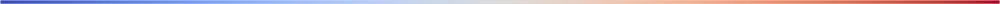

In [3]:
cmap = mpl.colors.ListedColormap(sns.color_palette("coolwarm", 256))
sns.palplot(sns.color_palette("coolwarm", 256))

# $B_z$ from bdot3a

## get probe locations

In [19]:
%%sh
source ~/.bashrc
cd ../output/intermediate/ 
idl -e "pro00170, 'bdot3a', 'z', shotset=1"  

modify IDL startup in /Users/vonderlinden2/rsx_drive/Applications/IDL/idl_startup.pro
executing that procedure now...
fundamental procedures are stored in /Users/vonderlinden2/rsx_drive/Applications/IDL/
use x11 xterm instead of terminal to maintain focus on the terminal
115110938869


IDL Version 8.5, Mac OS X (darwin x86_64 m64).
(c) 2015, Exelis Visual Information Solutions, Inc., a subsidiary of Harris Corporation.
Installation number: 5697-1.
Licensed for use by: ENERGY - LAWRENCE LIVERMORE NATIONAL LAB

% LOADCT: Loading table RED TEMPERATURE
% Compiled module: PRO00170.
% Compiled module: GET_SHOTS.
% Compiled module: GET_SENSOR.
% Compiled module: PRO00130.
% Compiled module: TRANSFORM_SENSOR.
% Compiled module: PRO00160.
% Compiled module: PRO00C00.
% Compiled module: PRO00B00.
% Compiled module: PRO00C20.
% LOADCT: Loading table RED TEMPERATURE
% Compiled module: PROCEDURE_PATH.
% Compiled module: STAMP.
% READ: End of file encountered. Unit: 0, File: <stdin>
% Execution halted at: STAMP              51
   /Users/vonderlinden2/rsx_drive/Applications/IDL/stamp.pro
%                      PRO00170          160
   /Users/vonderlinden2/rsx_drive/RSX/IDL/pro00170.pro
%                      $MAIN$          


In [24]:
b_z_bdot3a_pos = idl.readsav('../output/intermediate/115110938869.sav', verbose=True)

--------------------------------------------------
Date: Mon Nov  9 10:47:49 2015
User: vonderlinden2
Host: n9114737.llnl.gov
--------------------------------------------------
Format: 12
Architecture: x86_64
Operating System: darwin
IDL Version: 8.5
--------------------------------------------------
Successfully read 5 records of which:
 - 2 are of type VARIABLE
 - 1 are of type TIMESTAMP
 - 1 are of type VERSION
--------------------------------------------------
Available variables:
 - x_out [<type 'numpy.ndarray'>]
 - y_out [<type 'numpy.ndarray'>]
--------------------------------------------------


# get post-processed magnetic field measurements 

In [21]:
%%sh
source ~/.bashrc
cd ../output/intermediate/
idl -e "pro00710,'bdot3a','z','b',indgen(21)/50.-0.085,0,shotset='001',/cur"

modify IDL startup in /Users/vonderlinden2/rsx_drive/Applications/IDL/idl_startup.pro
executing that procedure now...
fundamental procedures are stored in /Users/vonderlinden2/rsx_drive/Applications/IDL/
use x11 xterm instead of terminal to maintain focus on the terminal
basename:    115110938897


IDL Version 8.5, Mac OS X (darwin x86_64 m64).
(c) 2015, Exelis Visual Information Solutions, Inc., a subsidiary of Harris Corporation.
Installation number: 5697-1.
Licensed for use by: ENERGY - LAWRENCE LIVERMORE NATIONAL LAB

% LOADCT: Loading table RED TEMPERATURE
% Compiled module: PRO00710.
% Compiled module: PRO00C00.
% Compiled module: PRO00150.
% Compiled module: GET_SHOTS.
% Compiled module: GET_SENSOR.
% Compiled module: PRO00130.
% Compiled module: TRANSFORM_SENSOR.
% Compiled module: PRO00140.
% Compiled module: PRO00100.
% Compiled module: MDSOPEN.
% Compiled module: MDSVALUE.
% Compiled module: MDSCHECKARG.
% Compiled module: MDSISCLIENT.
% Compiled module: MDSIDLIMAGE.
% Compiled module: PRO00160.
% Compiled module: MDSCLOSE.
% Compiled module: PRO0060C.
% Compiled module: PROCEDURE_PATH.
% Compiled module: STAMP.
% READ: End of file encountered. Unit: 0, File: <stdin>
% Execution halted at: STAMP              51
   /Users/vonderlinden2/rsx_drive/Applications/IDL/stamp.p

In [25]:
b_z_bdot3a_dict = idl.readsav('../output/intermediate/115110938897.sav', 
                              verbose=True)

--------------------------------------------------
Date: Mon Nov  9 10:48:41 2015
User: vonderlinden2
Host: n9114737.llnl.gov
--------------------------------------------------
Format: 12
Architecture: x86_64
Operating System: darwin
IDL Version: 8.5
--------------------------------------------------
Successfully read 7 records of which:
 - 4 are of type VARIABLE
 - 1 are of type TIMESTAMP
 - 1 are of type VERSION
--------------------------------------------------
Available variables:
 - x_out [<type 'numpy.ndarray'>]
 - delays [<type 'numpy.ndarray'>]
 - y_out [<type 'numpy.ndarray'>]
 - a_out [<type 'numpy.ndarray'>]
--------------------------------------------------


## Contour plots of $B_z$ at $z=0.25$ (B_z at z=0.25)

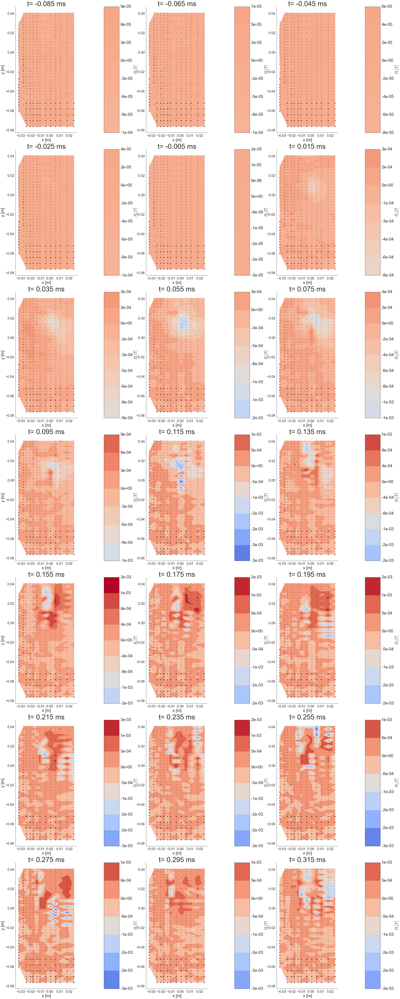

In [74]:
plot_contours_in_time(b_z_bdot3a_dict, b_z_bdot3a_pos, cmap, 
                      np.arange(21), r'$B_{z} [T]$', columns=3, rows=7)

# $B_x$ from Bdot probe 3a

In [59]:
%%sh
source ~/.bashrc
cd ../output/intermediate/
idl -e "pro00170, 'bdot3a', 'x', shotset=1"

modify IDL startup in /Users/vonderlinden2/rsx_drive/Applications/IDL/idl_startup.pro
executing that procedure now...
fundamental procedures are stored in /Users/vonderlinden2/rsx_drive/Applications/IDL/
use x11 xterm instead of terminal to maintain focus on the terminal
115110949362


IDL Version 8.5, Mac OS X (darwin x86_64 m64).
(c) 2015, Exelis Visual Information Solutions, Inc., a subsidiary of Harris Corporation.
Installation number: 5697-1.
Licensed for use by: ENERGY - LAWRENCE LIVERMORE NATIONAL LAB

% LOADCT: Loading table RED TEMPERATURE
% Compiled module: PRO00170.
% Compiled module: GET_SHOTS.
% Compiled module: GET_SENSOR.
% Compiled module: PRO00130.
% Compiled module: TRANSFORM_SENSOR.
% Compiled module: PRO00160.
% Compiled module: PRO00C00.
% Compiled module: PRO00B00.
% Compiled module: PRO00C20.
% LOADCT: Loading table RED TEMPERATURE
% Compiled module: PROCEDURE_PATH.
% Compiled module: STAMP.
% READ: End of file encountered. Unit: 0, File: <stdin>
% Execution halted at: STAMP              51
   /Users/vonderlinden2/rsx_drive/Applications/IDL/stamp.pro
%                      PRO00170          160
   /Users/vonderlinden2/rsx_drive/RSX/IDL/pro00170.pro
%                      $MAIN$          


In [50]:
b_x_bdot3a_pos = idl.readsav('../output/intermediate/115110949362.sav',
                             verbose=True)

--------------------------------------------------
Date: Mon Nov  9 13:42:42 2015
User: vonderlinden2
Host: n9114737.llnl.gov
--------------------------------------------------
Format: 12
Architecture: x86_64
Operating System: darwin
IDL Version: 8.5
--------------------------------------------------
Successfully read 5 records of which:
 - 2 are of type VARIABLE
 - 1 are of type TIMESTAMP
 - 1 are of type VERSION
--------------------------------------------------
Available variables:
 - x_out [<type 'numpy.ndarray'>]
 - y_out [<type 'numpy.ndarray'>]
--------------------------------------------------


In [61]:
%%sh
source ~/.bashrc
cd ../output/intermediate/
idl -e "pro00710,'bdot3a','x','b',indgen(21)/50.-0.085,0,shotset='001',/cur"

modify IDL startup in /Users/vonderlinden2/rsx_drive/Applications/IDL/idl_startup.pro
executing that procedure now...
fundamental procedures are stored in /Users/vonderlinden2/rsx_drive/Applications/IDL/
use x11 xterm instead of terminal to maintain focus on the terminal
basename:    115110949410


IDL Version 8.5, Mac OS X (darwin x86_64 m64).
(c) 2015, Exelis Visual Information Solutions, Inc., a subsidiary of Harris Corporation.
Installation number: 5697-1.
Licensed for use by: ENERGY - LAWRENCE LIVERMORE NATIONAL LAB

% LOADCT: Loading table RED TEMPERATURE
% Compiled module: PRO00710.
% Compiled module: PRO00C00.
% Compiled module: PRO00150.
% Compiled module: GET_SHOTS.
% Compiled module: GET_SENSOR.
% Compiled module: PRO00130.
% Compiled module: TRANSFORM_SENSOR.
% Compiled module: PRO00140.
% Compiled module: PRO00100.
% Compiled module: MDSOPEN.
% Compiled module: MDSVALUE.
% Compiled module: MDSCHECKARG.
% Compiled module: MDSISCLIENT.
% Compiled module: MDSIDLIMAGE.
% Compiled module: PRO00160.
% Compiled module: MDSCLOSE.
% Compiled module: PRO0060C.
% Compiled module: PROCEDURE_PATH.
% Compiled module: STAMP.
% READ: End of file encountered. Unit: 0, File: <stdin>
% Execution halted at: STAMP              51
   /Users/vonderlinden2/rsx_drive/Applications/IDL/stamp.p

In [63]:
b_x_bdot3a_dict = idl.readsav('../output/intermediate/115110949410.sav',
                              verbose=True)

--------------------------------------------------
Date: Mon Nov  9 13:43:43 2015
User: vonderlinden2
Host: n9114737.llnl.gov
--------------------------------------------------
Format: 12
Architecture: x86_64
Operating System: darwin
IDL Version: 8.5
--------------------------------------------------
Successfully read 7 records of which:
 - 4 are of type VARIABLE
 - 1 are of type TIMESTAMP
 - 1 are of type VERSION
--------------------------------------------------
Available variables:
 - x_out [<type 'numpy.ndarray'>]
 - delays [<type 'numpy.ndarray'>]
 - y_out [<type 'numpy.ndarray'>]
 - a_out [<type 'numpy.ndarray'>]
--------------------------------------------------


## Contour plots of $B_x$ at $z=0.25$ (B_x at z=0.25)

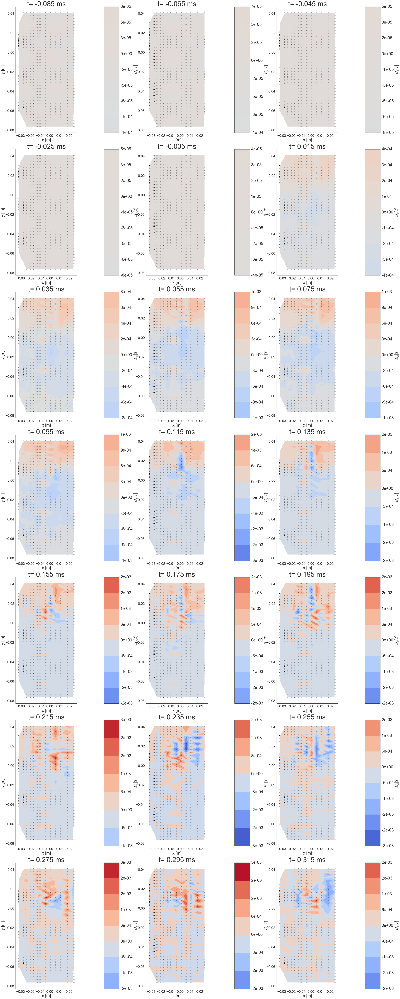

In [75]:
plot_contours_in_time(b_x_bdot3a_dict, b_x_bdot3a_pos, cmap, np.arange(21), 
                      r'$B_{x} [T]$', columns=3, rows=7)

# $B_{y}$ fom bdot probe 3a

In [65]:
%%sh
source ~/.bashrc
cd ../output/intermediate/
idl -e "pro00170, 'bdot3a', 'y', shotset=1"  

modify IDL startup in /Users/vonderlinden2/rsx_drive/Applications/IDL/idl_startup.pro
executing that procedure now...
fundamental procedures are stored in /Users/vonderlinden2/rsx_drive/Applications/IDL/
use x11 xterm instead of terminal to maintain focus on the terminal
115110949522


IDL Version 8.5, Mac OS X (darwin x86_64 m64).
(c) 2015, Exelis Visual Information Solutions, Inc., a subsidiary of Harris Corporation.
Installation number: 5697-1.
Licensed for use by: ENERGY - LAWRENCE LIVERMORE NATIONAL LAB

% LOADCT: Loading table RED TEMPERATURE
% Compiled module: PRO00170.
% Compiled module: GET_SHOTS.
% Compiled module: GET_SENSOR.
% Compiled module: PRO00130.
% Compiled module: TRANSFORM_SENSOR.
% Compiled module: PRO00160.
% Compiled module: PRO00C00.
% Compiled module: PRO00B00.
% Compiled module: PRO00C20.
% LOADCT: Loading table RED TEMPERATURE
% Compiled module: PROCEDURE_PATH.
% Compiled module: STAMP.
% READ: End of file encountered. Unit: 0, File: <stdin>
% Execution halted at: STAMP              51
   /Users/vonderlinden2/rsx_drive/Applications/IDL/stamp.pro
%                      PRO00170          160
   /Users/vonderlinden2/rsx_drive/RSX/IDL/pro00170.pro
%                      $MAIN$          


In [51]:
b_y_bdot3a_pos = idl.readsav('../output/intermediate/115110949522.sav',
                             verbose=True)

--------------------------------------------------
Date: Mon Nov  9 13:45:22 2015
User: vonderlinden2
Host: n9114737.llnl.gov
--------------------------------------------------
Format: 12
Architecture: x86_64
Operating System: darwin
IDL Version: 8.5
--------------------------------------------------
Successfully read 5 records of which:
 - 2 are of type VARIABLE
 - 1 are of type TIMESTAMP
 - 1 are of type VERSION
--------------------------------------------------
Available variables:
 - x_out [<type 'numpy.ndarray'>]
 - y_out [<type 'numpy.ndarray'>]
--------------------------------------------------


In [68]:
%%sh
source ~/.bashrc
cd ../output/intermediate/
idl -e "pro00710,'bdot3a','y','b',indgen(21)/50.-0.085,0,shotset='001',/cur"

modify IDL startup in /Users/vonderlinden2/rsx_drive/Applications/IDL/idl_startup.pro
executing that procedure now...
fundamental procedures are stored in /Users/vonderlinden2/rsx_drive/Applications/IDL/
use x11 xterm instead of terminal to maintain focus on the terminal
basename:    115110949594


IDL Version 8.5, Mac OS X (darwin x86_64 m64).
(c) 2015, Exelis Visual Information Solutions, Inc., a subsidiary of Harris Corporation.
Installation number: 5697-1.
Licensed for use by: ENERGY - LAWRENCE LIVERMORE NATIONAL LAB

% LOADCT: Loading table RED TEMPERATURE
% Compiled module: PRO00710.
% Compiled module: PRO00C00.
% Compiled module: PRO00150.
% Compiled module: GET_SHOTS.
% Compiled module: GET_SENSOR.
% Compiled module: PRO00130.
% Compiled module: TRANSFORM_SENSOR.
% Compiled module: PRO00140.
% Compiled module: PRO00100.
% Compiled module: MDSOPEN.
% Compiled module: MDSVALUE.
% Compiled module: MDSCHECKARG.
% Compiled module: MDSISCLIENT.
% Compiled module: MDSIDLIMAGE.
% Compiled module: PRO00160.
% Compiled module: MDSCLOSE.
% Compiled module: PRO0060C.
% Compiled module: PROCEDURE_PATH.
% Compiled module: STAMP.
% READ: End of file encountered. Unit: 0, File: <stdin>
% Execution halted at: STAMP              51
   /Users/vonderlinden2/rsx_drive/Applications/IDL/stamp.p

In [69]:
b_y_bdot3a_dict = idl.readsav('../output/intermediate/115110949594.sav', verbose=True)

--------------------------------------------------
Date: Mon Nov  9 13:47:11 2015
User: vonderlinden2
Host: n9114737.llnl.gov
--------------------------------------------------
Format: 12
Architecture: x86_64
Operating System: darwin
IDL Version: 8.5
--------------------------------------------------
Successfully read 7 records of which:
 - 4 are of type VARIABLE
 - 1 are of type TIMESTAMP
 - 1 are of type VERSION
--------------------------------------------------
Available variables:
 - x_out [<type 'numpy.ndarray'>]
 - delays [<type 'numpy.ndarray'>]
 - y_out [<type 'numpy.ndarray'>]
 - a_out [<type 'numpy.ndarray'>]
--------------------------------------------------


## Contour plots of $B_y$ at $z=0.25$  (B_y at z=0.25)

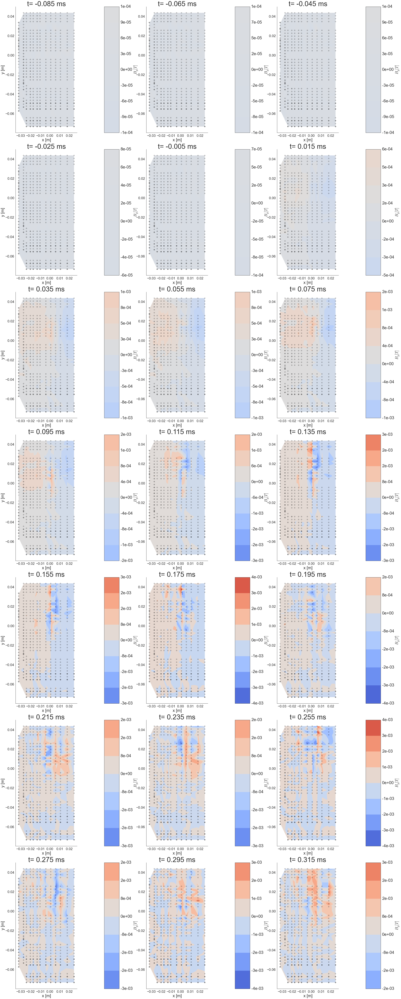

In [76]:
plot_contours_in_time(b_y_bdot3a_dict, b_y_bdot3a_pos, cmap, np.arange(21), 
                      r'$B_{y} [T]$', rows=7, columns=3)

# Temperature plot

In [4]:
%%sh
source ~/.bashrc
cd ../output/intermediate/ 
idl -e "pro00170, '3p1', 'z', shotset=1"  

modify IDL startup in /Users/vonderlinden2/rsx_drive/Applications/IDL/idl_startup.pro
executing that procedure now...
fundamental procedures are stored in /Users/vonderlinden2/rsx_drive/Applications/IDL/
use x11 xterm instead of terminal to maintain focus on the terminal
115112535917


IDL Version 8.5, Mac OS X (darwin x86_64 m64).
(c) 2015, Exelis Visual Information Solutions, Inc., a subsidiary of Harris Corporation.
Installation number: 5697-1.
Licensed for use by: ENERGY - LAWRENCE LIVERMORE NATIONAL LAB

% LOADCT: Loading table RED TEMPERATURE
% Compiled module: PRO00170.
% Compiled module: GET_SHOTS.
% Compiled module: GET_SENSOR.
% Compiled module: PRO00130.
% Compiled module: TRANSFORM_SENSOR.
% Compiled module: PRO00160.
% Compiled module: PRO00C00.
% Compiled module: PRO00B00.
% Compiled module: PRO00C20.
% LOADCT: Loading table RED TEMPERATURE
% Compiled module: PROCEDURE_PATH.
% Compiled module: STAMP.
% READ: End of file encountered. Unit: 0, File: <stdin>
% Execution halted at: STAMP              51
   /Users/vonderlinden2/rsx_drive/Applications/IDL/stamp.pro
%                      PRO00170          160
   /Users/vonderlinden2/rsx_drive/RSX/IDL/pro00170.pro
%                      $MAIN$          


In [6]:
triple_probe_1_pos = idl.readsav('../output/intermediate/115112535917.sav',
                                 verbose=True)

--------------------------------------------------
Date: Wed Nov 25 09:58:37 2015
User: vonderlinden2
Host: n9114737.llnl.gov
--------------------------------------------------
Format: 12
Architecture: x86_64
Operating System: darwin
IDL Version: 8.5
--------------------------------------------------
Successfully read 5 records of which:
 - 2 are of type VARIABLE
 - 1 are of type TIMESTAMP
 - 1 are of type VERSION
--------------------------------------------------
Available variables:
 - x_out [<type 'numpy.ndarray'>]
 - y_out [<type 'numpy.ndarray'>]
--------------------------------------------------


In [8]:
%%sh
source ~/.bashrc
cd ../output/intermediate/
idl -e "pro00710,'3p1','z','te',indgen(21)/50.-0.085,0,shotset='001',/cur"

modify IDL startup in /Users/vonderlinden2/rsx_drive/Applications/IDL/idl_startup.pro
executing that procedure now...
fundamental procedures are stored in /Users/vonderlinden2/rsx_drive/Applications/IDL/
use x11 xterm instead of terminal to maintain focus on the terminal
basename:    115112537135


IDL Version 8.5, Mac OS X (darwin x86_64 m64).
(c) 2015, Exelis Visual Information Solutions, Inc., a subsidiary of Harris Corporation.
Installation number: 5697-1.
Licensed for use by: ENERGY - LAWRENCE LIVERMORE NATIONAL LAB

% LOADCT: Loading table RED TEMPERATURE
% Compiled module: PRO00710.
% Compiled module: PRO00C00.
% Compiled module: PRO00150.
% Compiled module: GET_SHOTS.
% Compiled module: GET_SENSOR.
% Compiled module: PRO00130.
% Compiled module: TRANSFORM_SENSOR.
% Compiled module: PRO00140.
% Compiled module: PRO00100.
% Compiled module: MDSOPEN.
% Compiled module: MDSVALUE.
% Compiled module: MDSCHECKARG.
% Compiled module: MDSISCLIENT.
% Compiled module: MDSIDLIMAGE.
% Compiled module: PRO00160.
% Compiled module: MDSCLOSE.
% Compiled module: PROCEDURE_PATH.
% Compiled module: STAMP.
% READ: End of file encountered. Unit: 0, File: <stdin>
% Execution halted at: STAMP              51
   /Users/vonderlinden2/rsx_drive/Applications/IDL/stamp.pro
%                      PRO

In [9]:
triple_probe_1_temp = idl.readsav('../output/intermediate/115112537135.sav',
                                  verbose=True)

--------------------------------------------------
Date: Wed Nov 25 10:19:09 2015
User: vonderlinden2
Host: n9114737.llnl.gov
--------------------------------------------------
Format: 12
Architecture: x86_64
Operating System: darwin
IDL Version: 8.5
--------------------------------------------------
Successfully read 7 records of which:
 - 4 are of type VARIABLE
 - 1 are of type TIMESTAMP
 - 1 are of type VERSION
--------------------------------------------------
Available variables:
 - x_out [<type 'numpy.ndarray'>]
 - delays [<type 'numpy.ndarray'>]
 - y_out [<type 'numpy.ndarray'>]
 - a_out [<type 'numpy.ndarray'>]
--------------------------------------------------


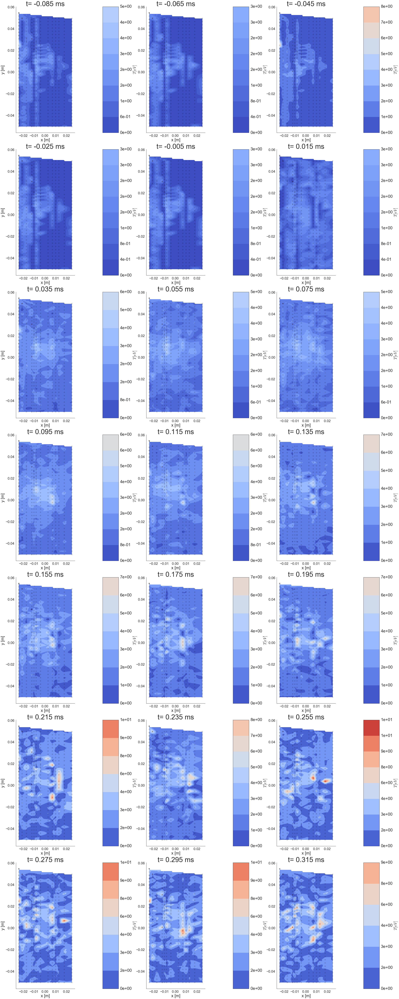

In [11]:
plot_contours_in_time(triple_probe_1_temp, triple_probe_1_pos, cmap, np.arange(21), 
                      r'$T [eV]$', rows=7, columns=3)

In [12]:
%%sh
source ~/.bashrc
cd ../output/intermediate/
idl -e "pro00710,'3p1','z','n',indgen(21)/50.-0.085,0,shotset='001',/cur"

modify IDL startup in /Users/vonderlinden2/rsx_drive/Applications/IDL/idl_startup.pro
executing that procedure now...
fundamental procedures are stored in /Users/vonderlinden2/rsx_drive/Applications/IDL/
use x11 xterm instead of terminal to maintain focus on the terminal
basename:    115112537372


IDL Version 8.5, Mac OS X (darwin x86_64 m64).
(c) 2015, Exelis Visual Information Solutions, Inc., a subsidiary of Harris Corporation.
Installation number: 5697-1.
Licensed for use by: ENERGY - LAWRENCE LIVERMORE NATIONAL LAB

% LOADCT: Loading table RED TEMPERATURE
% Compiled module: PRO00710.
% Compiled module: PRO00C00.
% Compiled module: PRO00150.
% Compiled module: GET_SHOTS.
% Compiled module: GET_SENSOR.
% Compiled module: PRO00130.
% Compiled module: TRANSFORM_SENSOR.
% Compiled module: PRO00140.
% Compiled module: PRO00100.
% Compiled module: MDSOPEN.
% Compiled module: MDSVALUE.
% Compiled module: MDSCHECKARG.
% Compiled module: MDSISCLIENT.
% Compiled module: MDSIDLIMAGE.
% Compiled module: PRO00160.
% Compiled module: MDSCLOSE.
% Compiled module: PROCEDURE_PATH.
% Compiled module: STAMP.
% READ: End of file encountered. Unit: 0, File: <stdin>
% Execution halted at: STAMP              51
   /Users/vonderlinden2/rsx_drive/Applications/IDL/stamp.pro
%                      PRO

In [15]:
triple_probe_1_dens = idl.readsav('../output/intermediate/115112537372.sav',
                                  verbose=True)

--------------------------------------------------
Date: Wed Nov 25 10:23:00 2015
User: vonderlinden2
Host: n9114737.llnl.gov
--------------------------------------------------
Format: 12
Architecture: x86_64
Operating System: darwin
IDL Version: 8.5
--------------------------------------------------
Successfully read 7 records of which:
 - 4 are of type VARIABLE
 - 1 are of type TIMESTAMP
 - 1 are of type VERSION
--------------------------------------------------
Available variables:
 - x_out [<type 'numpy.ndarray'>]
 - delays [<type 'numpy.ndarray'>]
 - y_out [<type 'numpy.ndarray'>]
 - a_out [<type 'numpy.ndarray'>]
--------------------------------------------------


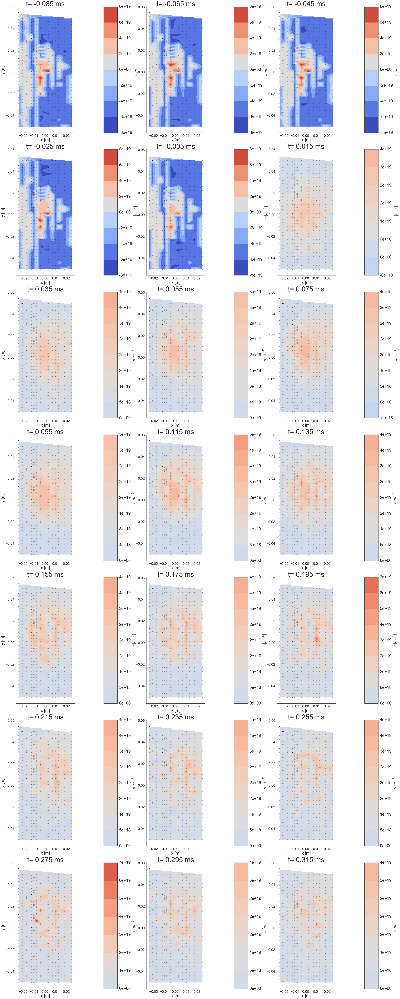

In [16]:
plot_contours_in_time(triple_probe_1_dens, triple_probe_1_pos, cmap, np.arange(21), 
                      r'$n [m^{-3}]$', rows=7, columns=3)

# $B_{z}$ plotted by phase

In [36]:
%%sh
source ~/.bashrc
cd ../output/intermediate/
idl -e "pro00710,'bdot3a','z','b',indgen(21)*1./20.,1,shotset='001',current_rise=0"

modify IDL startup in /Users/vonderlinden2/rsx_drive/Applications/IDL/idl_startup.pro
executing that procedure now...
fundamental procedures are stored in /Users/vonderlinden2/rsx_drive/Applications/IDL/
use x11 xterm instead of terminal to maintain focus on the terminal
basename:    115112539331


IDL Version 8.5, Mac OS X (darwin x86_64 m64).
(c) 2015, Exelis Visual Information Solutions, Inc., a subsidiary of Harris Corporation.
Installation number: 5697-1.
Licensed for use by: ENERGY - LAWRENCE LIVERMORE NATIONAL LAB

% LOADCT: Loading table RED TEMPERATURE
% Compiled module: PRO00710.
% Compiled module: PRO00C00.
% Compiled module: PRO00150.
% Compiled module: GET_SHOTS.
% Compiled module: GET_SENSOR.
% Compiled module: PRO00130.
% Compiled module: TRANSFORM_SENSOR.
% Compiled module: PRO00140.
% Compiled module: PRO00100.
% Compiled module: MDSOPEN.
% Compiled module: MDSVALUE.
% Compiled module: MDSCHECKARG.
% Compiled module: MDSISCLIENT.
% Compiled module: MDSIDLIMAGE.
% Compiled module: MDSCLOSE.
% Compiled module: PRO0060C.
% Compiled module: PRO00160.
% Compiled module: PROCEDURE_PATH.
% Compiled module: STAMP.
% READ: End of file encountered. Unit: 0, File: <stdin>
% Execution halted at: STAMP              51
   /Users/vonderlinden2/rsx_drive/Applications/IDL/stamp.p

In [42]:
b_z_bdot3a_phase = idl.readsav('../output/intermediate/115112539331.sav', verbose=True)

--------------------------------------------------
Date: Wed Nov 25 10:56:07 2015
User: vonderlinden2
Host: n9114737.llnl.gov
--------------------------------------------------
Format: 12
Architecture: x86_64
Operating System: darwin
IDL Version: 8.5
--------------------------------------------------
Successfully read 7 records of which:
 - 4 are of type VARIABLE
 - 1 are of type TIMESTAMP
 - 1 are of type VERSION
--------------------------------------------------
Available variables:
 - x_out [<type 'numpy.ndarray'>]
 - delays [<type 'numpy.ndarray'>]
 - y_out [<type 'numpy.ndarray'>]
 - a_out [<type 'numpy.ndarray'>]
--------------------------------------------------


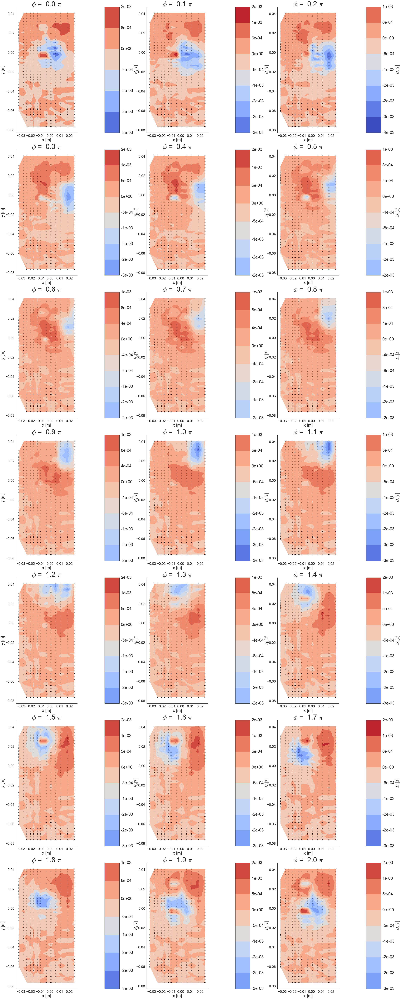

In [43]:
plot_contours_in_time(b_z_bdot3a_phase, b_z_bdot3a_pos, cmap, 
                      np.arange(21), r'$B_{z} [T]$', columns=3, 
                      rows=7, label='phase')

# $B_{x}$ plotted by phase

In [37]:
%%sh
source ~/.bashrc
cd ../output/intermediate/
idl -e "pro00710,'bdot3a','x','b',indgen(21)*1./20.,1,shotset='001',current_rise=0"

modify IDL startup in /Users/vonderlinden2/rsx_drive/Applications/IDL/idl_startup.pro
executing that procedure now...
fundamental procedures are stored in /Users/vonderlinden2/rsx_drive/Applications/IDL/
use x11 xterm instead of terminal to maintain focus on the terminal
basename:    115112539367


IDL Version 8.5, Mac OS X (darwin x86_64 m64).
(c) 2015, Exelis Visual Information Solutions, Inc., a subsidiary of Harris Corporation.
Installation number: 5697-1.
Licensed for use by: ENERGY - LAWRENCE LIVERMORE NATIONAL LAB

% LOADCT: Loading table RED TEMPERATURE
% Compiled module: PRO00710.
% Compiled module: PRO00C00.
% Compiled module: PRO00150.
% Compiled module: GET_SHOTS.
% Compiled module: GET_SENSOR.
% Compiled module: PRO00130.
% Compiled module: TRANSFORM_SENSOR.
% Compiled module: PRO00140.
% Compiled module: PRO00100.
% Compiled module: MDSOPEN.
% Compiled module: MDSVALUE.
% Compiled module: MDSCHECKARG.
% Compiled module: MDSISCLIENT.
% Compiled module: MDSIDLIMAGE.
% Compiled module: MDSCLOSE.
% Compiled module: PRO0060C.
% Compiled module: PRO00160.
% Compiled module: PROCEDURE_PATH.
% Compiled module: STAMP.
% READ: End of file encountered. Unit: 0, File: <stdin>
% Execution halted at: STAMP              51
   /Users/vonderlinden2/rsx_drive/Applications/IDL/stamp.p

In [44]:
b_x_bdot3a_phase = idl.readsav('../output/intermediate/115112539367.sav', verbose=True)

--------------------------------------------------
Date: Wed Nov 25 10:56:24 2015
User: vonderlinden2
Host: n9114737.llnl.gov
--------------------------------------------------
Format: 12
Architecture: x86_64
Operating System: darwin
IDL Version: 8.5
--------------------------------------------------
Successfully read 7 records of which:
 - 4 are of type VARIABLE
 - 1 are of type TIMESTAMP
 - 1 are of type VERSION
--------------------------------------------------
Available variables:
 - x_out [<type 'numpy.ndarray'>]
 - delays [<type 'numpy.ndarray'>]
 - y_out [<type 'numpy.ndarray'>]
 - a_out [<type 'numpy.ndarray'>]
--------------------------------------------------


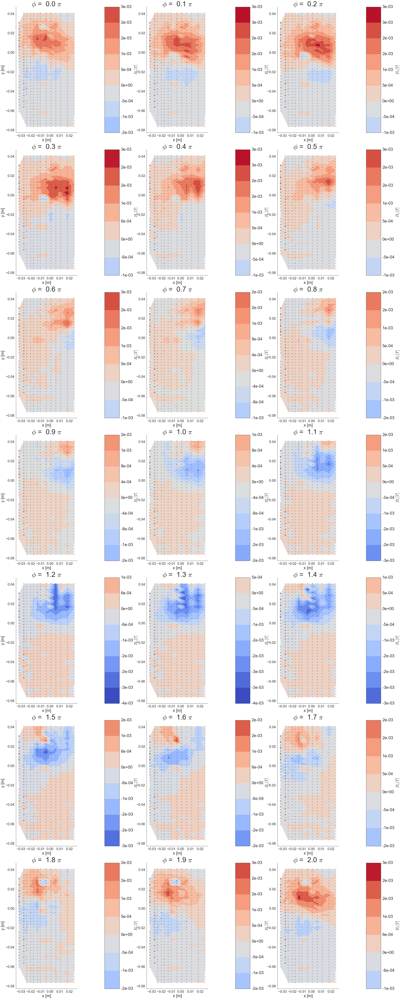

In [55]:
plot_contours_in_time(b_x_bdot3a_phase, b_x_bdot3a_pos, cmap, 
                      np.arange(21), r'$B_{x} [T]$', columns=3, 
                      rows=7, label='phase')

# $B_{y}$ plotted by phase

In [38]:
%%sh
source ~/.bashrc
cd ../output/intermediate/
idl -e "pro00710,'bdot3a','y','b',indgen(21)*1./20.,1,shotset='001',current_rise=0"

modify IDL startup in /Users/vonderlinden2/rsx_drive/Applications/IDL/idl_startup.pro
executing that procedure now...
fundamental procedures are stored in /Users/vonderlinden2/rsx_drive/Applications/IDL/
use x11 xterm instead of terminal to maintain focus on the terminal
basename:    115112539384


IDL Version 8.5, Mac OS X (darwin x86_64 m64).
(c) 2015, Exelis Visual Information Solutions, Inc., a subsidiary of Harris Corporation.
Installation number: 5697-1.
Licensed for use by: ENERGY - LAWRENCE LIVERMORE NATIONAL LAB

% LOADCT: Loading table RED TEMPERATURE
% Compiled module: PRO00710.
% Compiled module: PRO00C00.
% Compiled module: PRO00150.
% Compiled module: GET_SHOTS.
% Compiled module: GET_SENSOR.
% Compiled module: PRO00130.
% Compiled module: TRANSFORM_SENSOR.
% Compiled module: PRO00140.
% Compiled module: PRO00100.
% Compiled module: MDSOPEN.
% Compiled module: MDSVALUE.
% Compiled module: MDSCHECKARG.
% Compiled module: MDSISCLIENT.
% Compiled module: MDSIDLIMAGE.
% Compiled module: MDSCLOSE.
% Compiled module: PRO0060C.
% Compiled module: PRO00160.
% Compiled module: PROCEDURE_PATH.
% Compiled module: STAMP.
% READ: End of file encountered. Unit: 0, File: <stdin>
% Execution halted at: STAMP              51
   /Users/vonderlinden2/rsx_drive/Applications/IDL/stamp.p

In [47]:
b_y_bdot3a_phase = idl.readsav('../output/intermediate/115112539384.sav', verbose=True)

--------------------------------------------------
Date: Wed Nov 25 10:57:02 2015
User: vonderlinden2
Host: n9114737.llnl.gov
--------------------------------------------------
Format: 12
Architecture: x86_64
Operating System: darwin
IDL Version: 8.5
--------------------------------------------------
Successfully read 7 records of which:
 - 4 are of type VARIABLE
 - 1 are of type TIMESTAMP
 - 1 are of type VERSION
--------------------------------------------------
Available variables:
 - x_out [<type 'numpy.ndarray'>]
 - delays [<type 'numpy.ndarray'>]
 - y_out [<type 'numpy.ndarray'>]
 - a_out [<type 'numpy.ndarray'>]
--------------------------------------------------


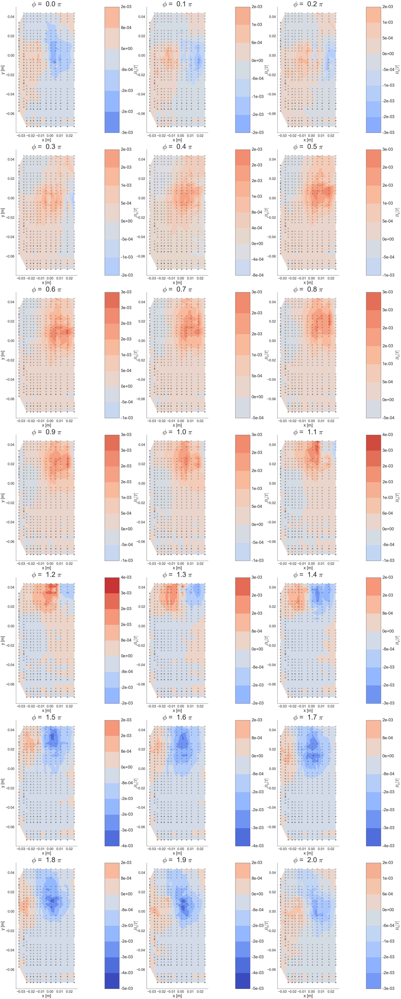

In [57]:
plot_contours_in_time(b_y_bdot3a_phase, b_y_bdot3a_pos, cmap, 
                      np.arange(21), r'$B_{y} [T]$', columns=3, 
                      rows=7, label='phase')

# $T_{e}$ plotted by phase

In [40]:
%%sh
source ~/.bashrc
cd ../output/intermediate/
idl -e "pro00710,'3p1','z','te',indgen(21)*1./20.,1,shotset='001',current_rise=0"

modify IDL startup in /Users/vonderlinden2/rsx_drive/Applications/IDL/idl_startup.pro
executing that procedure now...
fundamental procedures are stored in /Users/vonderlinden2/rsx_drive/Applications/IDL/
use x11 xterm instead of terminal to maintain focus on the terminal
basename:    115112539427


IDL Version 8.5, Mac OS X (darwin x86_64 m64).
(c) 2015, Exelis Visual Information Solutions, Inc., a subsidiary of Harris Corporation.
Installation number: 5697-1.
Licensed for use by: ENERGY - LAWRENCE LIVERMORE NATIONAL LAB

% LOADCT: Loading table RED TEMPERATURE
% Compiled module: PRO00710.
% Compiled module: PRO00C00.
% Compiled module: PRO00150.
% Compiled module: GET_SHOTS.
% Compiled module: GET_SENSOR.
% Compiled module: PRO00130.
% Compiled module: TRANSFORM_SENSOR.
% Compiled module: PRO00140.
% Compiled module: PRO00100.
% Compiled module: MDSOPEN.
% Compiled module: MDSVALUE.
% Compiled module: MDSCHECKARG.
% Compiled module: MDSISCLIENT.
% Compiled module: MDSIDLIMAGE.
% Compiled module: MDSCLOSE.
% Compiled module: PRO00160.
% Compiled module: PROCEDURE_PATH.
% Compiled module: STAMP.
% READ: End of file encountered. Unit: 0, File: <stdin>
% Execution halted at: STAMP              51
   /Users/vonderlinden2/rsx_drive/Applications/IDL/stamp.pro
%                      PRO

In [54]:
te_3p1_phase = idl.readsav('../output/intermediate/115112539427.sav', verbose=True)

--------------------------------------------------
Date: Wed Nov 25 10:57:22 2015
User: vonderlinden2
Host: n9114737.llnl.gov
--------------------------------------------------
Format: 12
Architecture: x86_64
Operating System: darwin
IDL Version: 8.5
--------------------------------------------------
Successfully read 7 records of which:
 - 4 are of type VARIABLE
 - 1 are of type TIMESTAMP
 - 1 are of type VERSION
--------------------------------------------------
Available variables:
 - x_out [<type 'numpy.ndarray'>]
 - delays [<type 'numpy.ndarray'>]
 - y_out [<type 'numpy.ndarray'>]
 - a_out [<type 'numpy.ndarray'>]
--------------------------------------------------


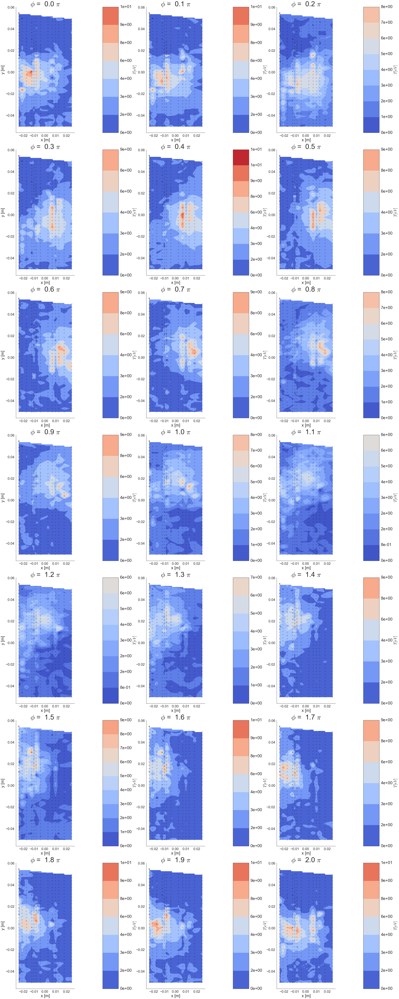

In [58]:
plot_contours_in_time(te_3p1_phase, triple_probe_1_pos, cmap, 
                      np.arange(21), r'$T [eV]$', columns=3, 
                      rows=7, label='phase')

# $n$ plotted by phase

In [41]:
%%sh
source ~/.bashrc
cd ../output/intermediate/
idl -e "pro00710,'3p1','z','n',indgen(21)*1./20.,1,shotset='001',current_rise=0"

modify IDL startup in /Users/vonderlinden2/rsx_drive/Applications/IDL/idl_startup.pro
executing that procedure now...
fundamental procedures are stored in /Users/vonderlinden2/rsx_drive/Applications/IDL/
use x11 xterm instead of terminal to maintain focus on the terminal
basename:    115112539443


IDL Version 8.5, Mac OS X (darwin x86_64 m64).
(c) 2015, Exelis Visual Information Solutions, Inc., a subsidiary of Harris Corporation.
Installation number: 5697-1.
Licensed for use by: ENERGY - LAWRENCE LIVERMORE NATIONAL LAB

% LOADCT: Loading table RED TEMPERATURE
% Compiled module: PRO00710.
% Compiled module: PRO00C00.
% Compiled module: PRO00150.
% Compiled module: GET_SHOTS.
% Compiled module: GET_SENSOR.
% Compiled module: PRO00130.
% Compiled module: TRANSFORM_SENSOR.
% Compiled module: PRO00140.
% Compiled module: PRO00100.
% Compiled module: MDSOPEN.
% Compiled module: MDSVALUE.
% Compiled module: MDSCHECKARG.
% Compiled module: MDSISCLIENT.
% Compiled module: MDSIDLIMAGE.
% Compiled module: MDSCLOSE.
% Compiled module: PRO00160.
% Compiled module: PROCEDURE_PATH.
% Compiled module: STAMP.
% READ: End of file encountered. Unit: 0, File: <stdin>
% Execution halted at: STAMP              51
   /Users/vonderlinden2/rsx_drive/Applications/IDL/stamp.pro
%                      PRO

In [61]:
n_3p1_phase = idl.readsav('../output/intermediate/115112539443.sav', verbose=True)

--------------------------------------------------
Date: Wed Nov 25 10:57:35 2015
User: vonderlinden2
Host: n9114737.llnl.gov
--------------------------------------------------
Format: 12
Architecture: x86_64
Operating System: darwin
IDL Version: 8.5
--------------------------------------------------
Successfully read 7 records of which:
 - 4 are of type VARIABLE
 - 1 are of type TIMESTAMP
 - 1 are of type VERSION
--------------------------------------------------
Available variables:
 - x_out [<type 'numpy.ndarray'>]
 - delays [<type 'numpy.ndarray'>]
 - y_out [<type 'numpy.ndarray'>]
 - a_out [<type 'numpy.ndarray'>]
--------------------------------------------------


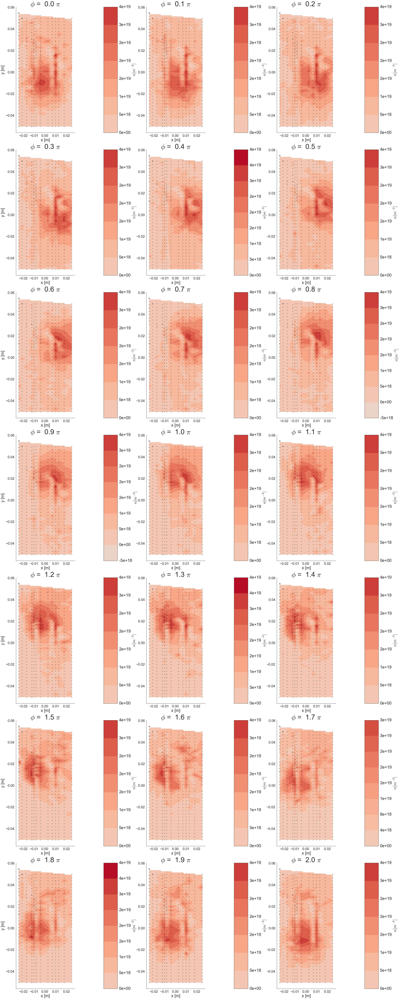

In [62]:
plot_contours_in_time(n_3p1_phase, triple_probe_1_pos, cmap, 
                      np.arange(21), r'$n [m^{-3}]$', columns=3, 
                      rows=7, label='phase')